Import

In [1]:
import random
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import matplotlib.pyplot as plt
import numpy as np
import tarfile
import os

from timeit import default_timer as timer
from tqdm.auto import tqdm
from torchvision import datasets, models, transforms
from torchsummary import summary
from typing import Callable, Dict, List, Tuple, Union
from torch.optim import lr_scheduler
from torch.utils.tensorboard import SummaryWriter
from captum.attr import IntegratedGradients
from pytorch_grad_cam import GradCAM


Riproducibilità

In [2]:
def fix_random(seed: int) -> None:
    """Fix all the possible sources of randomness.

    Args:
        seed: the seed to use.
    """
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

fix_random(seed=7)

Setting GPU

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print('Device:', device)

# The rest of your code using the device

Device: cpu


Montare Drive

In [4]:
"""from google.colab import drive
drive.mount('/content/drive')"""

"from google.colab import drive\ndrive.mount('/content/drive')"

Dataset

In [4]:
path_ds = 'archive'
path_ds_train = os.path.join(path_ds, 'train')
path_ds_val = os.path.join(path_ds, 'valid')

mean_image_net = [0.485, 0.456, 0.406]
std_image_net = [0.229, 0.224, 0.225]

normalize = transforms.Normalize(mean_image_net, std_image_net)

size_image = 224
data_transforms = {'train': transforms.Compose([transforms.RandomResizedCrop(size_image),
                                                transforms.RandomHorizontalFlip(),
                                                transforms.ToTensor(),
                                                normalize]),

                   'val': transforms.Compose([transforms.Resize(int(size_image*1.2)),
                                              transforms.CenterCrop(size_image),
                                              transforms.ToTensor(),
                                              normalize])}

data_train = torchvision.datasets.ImageFolder(path_ds_train, data_transforms['train'])
data_val = torchvision.datasets.ImageFolder(path_ds_val, data_transforms['val'])

classes = data_train.classes
num_classes = len(classes)

Show some examples

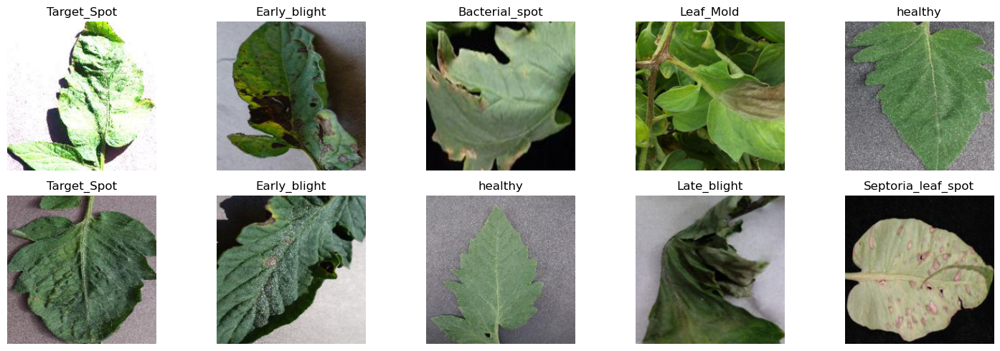

In [5]:
class NormalizeInverse(torchvision.transforms.Normalize):
    def __init__(self, mean: List[float], std: List[float]) -> None:
        """Reconstructs the images in the input domain by inverting
        the normalization transformation.

        Args:
            mean: the mean used to normalize the images.
            std: the standard deviation used to normalize the images.
        """
        mean = torch.as_tensor(mean)
        std = torch.as_tensor(std)
        std_inv = 1 / (std + 1e-7)
        mean_inv = -mean * std_inv
        super().__init__(mean=mean_inv, std=std_inv)

    def __call__(self, tensor):
        return super().__call__(tensor.clone())

def show_grid(dataset: torchvision.datasets.ImageFolder,
              process: Callable = None) -> None:
    """Shows a grid with random images taken from the dataset.

    Args:
        dataset: the dataset containing the images.
        process: a function to apply on the images before showing them.
    """
    fig = plt.figure(figsize=(15, 5))
    indices_random = np.random.randint(10, size=10, high=len(dataset))

    for count, idx in enumerate(indices_random):
        fig.add_subplot(2, 5, count + 1)
        title = dataset.classes[dataset[idx][1]]
        plt.title(title)
        image_processed = process(dataset[idx][0]) if process is not None else dataset[idx][0]
        plt.imshow(transforms.ToPILImage()(image_processed))
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Show some examples
denormalize = NormalizeInverse(mean_image_net, std_image_net)
show_grid(data_val, process=denormalize)

Distribution

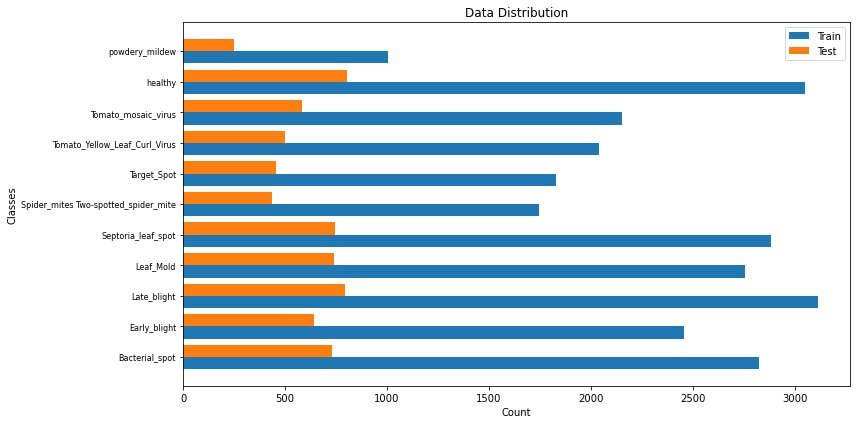

In [6]:
def plot_histograms(dataset_train: torchvision.datasets.ImageFolder,
                    dataset_test: torchvision.datasets.ImageFolder,
                    title: str,
                    classes_as_ticks: bool = True) -> None:
    """Plot histograms with train and test or validation data distributions.

    Args:
        dataset_train: the train dataset.
        dataset_test: the test or validation dataset.
        title: the title of the plot.
        classes_as_ticks: if true the name of the classes are shown on the x-axis.
    """
    classes = len(dataset_train.classes)
    bins = np.linspace(0, classes, classes + 1, dtype=int)
    plt.figure(figsize=(12, 6))  # Increase the figure size to make space for the labels
    plt.title(title)

    # Compute histogram data
    train_hist, train_bins = np.histogram(dataset_train.targets, bins=bins)
    test_hist, test_bins = np.histogram(dataset_test.targets, bins=bins)

    # Calculate bar width
    bar_width = 0.4

    # Positions for the bars
    r1 = np.arange(len(train_hist))
    r2 = [x + bar_width for x in r1]

    # Draw the bars
    plt.barh(r1, train_hist, height=bar_width, align='center', label='Train')
    plt.barh(r2, test_hist, height=bar_width, align='center', label='Test')

    # Set ticks and labels
    plt.yticks(r1 + bar_width / 2, dataset_train.classes, fontsize=8)
    plt.xlabel('Count')
    plt.ylabel('Classes')

    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.show()

plot_histograms(data_train, data_val, "Data Distribution")



Data Loaders

In [6]:
num_workers = 2
size_batch = 64

loader_train = torch.utils.data.DataLoader(data_train, batch_size=size_batch,
                                           shuffle=True,
                                           pin_memory=True, # speed-up CPU-GPU transfer
                                           num_workers=num_workers)

loader_val = torch.utils.data.DataLoader(data_val, batch_size=size_batch,
                                         shuffle=False,
                                         num_workers=num_workers)

Training functions

In [7]:
# Accuracy
def get_correct_samples(scores: torch.Tensor, labels: torch.Tensor) -> int:
    """Gets the number of correctly classified examples.

    Args:
        scores: the scores predicted with the network.
        labels: the class labels.

    Returns:
        the number of correct samples.
    """
    classes_predicted = torch.argmax(scores, 1)
    return (classes_predicted == labels).sum().item()

# Train one epoch
def train(writer: utils.tensorboard.writer.SummaryWriter,
          model: nn.Module,
          train_loader: utils.data.DataLoader,
          device: torch.device,
          optimizer: torch.optim,
          criterion: Callable[[torch.Tensor, torch.Tensor], float],
          log_interval: int,
          epoch: int) -> Tuple[float, float]:
    """Trains a neural network for one epoch.

    Args:
        model: the model to train.
        train_loader: the data loader containing the training data.
        device: the device to use to train the model.
        optimizer: the optimizer to use to train the model.
        criterion: the loss to optimize.
        log_interval: the log interval.
        epoch: the number of the current epoch.

    Returns:
        the cross entropy Loss value on the training data.
        the accuracy on the training data.
    """
    correct = 0
    samples_train = 0
    loss_train = 0
    size_ds_train = len(train_loader.dataset)
    num_batches = len(train_loader)

    model.train()
    for idx_batch, (images, labels) in enumerate(train_loader):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()

        scores = model(images)

        loss = criterion(scores, labels)
        loss_train += loss.item() * len(images)
        samples_train += len(images)

        loss.backward()
        optimizer.step()
        correct += get_correct_samples(scores, labels)

        if log_interval > 0:
            if idx_batch % log_interval == 0:
                running_loss = loss_train / samples_train
                global_step = idx_batch + (epoch * num_batches)
                writer.add_scalar('Metrics/Loss_Train_IT', running_loss, global_step)
                # Visualize images on tensorboard
                indices_random = torch.randperm(images.size(0))[:4]
                writer.add_images('Samples/Train', denormalize(images[indices_random]), global_step)

    loss_train /= samples_train
    accuracy_training = 100. * correct / samples_train
    return loss_train, accuracy_training

# Validate one epoch
def validate(model: nn.Module,
             data_loader: utils.data.DataLoader,
             device: torch.device,
             criterion: Callable[[torch.Tensor, torch.Tensor], float]) -> Tuple[float, float]:
    """Evaluates the model.

    Args:
        model: the model to evalaute.
        data_loader: the data loader containing the validation or test data.
        device: the device to use to evaluate the model.
        criterion: the loss function.

    Returns:
        the loss value on the validation data.
        the accuracy on the validation data.
    """
    correct = 0
    samples_val = 0
    loss_val = 0.
    model = model.eval()
    with torch.no_grad():
        for idx_batch, (images, labels) in enumerate(data_loader):
            images, labels = images.to(device), labels.to(device)
            scores = model(images)

            loss = criterion(scores, labels)
            loss_val += loss.item() * len(images)
            samples_val += len(images)
            correct += get_correct_samples(scores, labels)

    loss_val /= samples_val
    accuracy = 100. * correct / samples_val
    return loss_val, accuracy

Training Loop

In [8]:

def training_loop(writer: utils.tensorboard.writer.SummaryWriter,
                  num_epochs: int,
                  optimizer: torch.optim,
                  lr_scheduler: torch.optim.lr_scheduler,
                  log_interval: int,
                  model: nn.Module,
                  loader_train: utils.data.DataLoader,
                  loader_val: utils.data.DataLoader,
                  verbose: bool=True) -> Dict:
    """Executes the training loop.

        Args:
            writer: the summary writer for tensorboard.
            num_epochs: the number of epochs.
            optimizer: the optimizer to use.
            lr_scheduler: the scheduler for the learning rate.
            log_interval: intervall to print on tensorboard.
            model: the mode to train.
            loader_train: the data loader containing the training data.
            loader_val: the data loader containing the validation data.
            verbose: if true print the value of loss.

        Returns:
            A dictionary with the statistics computed during the train:
            the values for the train loss for each epoch.
            the values for the train accuracy for each epoch.
            the values for the validation accuracy for each epoch.
            the time of execution in seconds for the entire loop.
    """
    criterion = nn.CrossEntropyLoss()
    loop_start = timer()

    losses_values = []
    train_acc_values = []
    val_acc_values = []
    #Keep track of better performance
    best_val_accuracy = 0.0
    best_epoch = 0  
    best_state= None
    
    # Folder where the programs saves the weights
    save_folder = "weights"
    os.makedirs(save_folder, exist_ok=True)

    for epoch in range(1, num_epochs + 1):
        time_start = timer()
        loss_train, accuracy_train = train(writer, model, loader_train, device,
                                           optimizer, criterion, log_interval,
                                           epoch)
        loss_val, accuracy_val = validate(model, loader_val, device, criterion)
        time_end = timer()

        losses_values.append(loss_train)
        train_acc_values.append(accuracy_train)
        val_acc_values.append(accuracy_val)

        lr = optimizer.param_groups[0]['lr']

        if verbose:
            print(f'Epoch: {epoch} '
                  f' Lr: {lr:.8f} '
                  f' Loss: Train = [{loss_train:.4f}] - Val = [{loss_val:.4f}] '
                  f' Accuracy: Train = [{accuracy_train:.2f}%] - Val = [{accuracy_val:.2f}%] '
                  f' Time one epoch (s): {(time_end - time_start):.4f} ')

        # Plot to tensorboard
        writer.add_scalar('Hyperparameters/Learning Rate', lr, epoch)
        writer.add_scalars('Metrics/Losses', {"Train": loss_train, "Val": loss_val}, epoch)
        writer.add_scalars('Metrics/Accuracy', {"Train": accuracy_train, "Val": accuracy_val}, epoch)
        writer.flush()

        # Increases the internal counter
        if lr_scheduler:
            lr_scheduler.step()
        
        # Save the weights if you have a better performance
         # Aggiornamento dei pesi solo se la prestazione migliora alla fine dell'epoca
        if accuracy_val > best_val_accuracy:
            best_val_accuracy = accuracy_val
            best_epoch = epoch
            best_state = model.state_dict()
        
     # Saving weights of best epoch
    if best_state is not None:
        save_path = os.path.join(save_folder, "best_model.pth")
        torch.save(best_state, save_path)
        print(f"Best validation accuracy ({best_val_accuracy:.2f}%) in epoch {best_epoch}. Model saved in 'weights' folder.")

    loop_end = timer()
    time_loop = loop_end - loop_start
    if verbose:
        print(f'Time for {num_epochs} epochs (s): {(time_loop):.3f}')

    return {'loss_values': losses_values,
            'train_acc_values': train_acc_values,
            'val_acc_values': val_acc_values,
            'time': time_loop}

Execute

In [9]:
def execute(name_train: str, network: nn.Module, starting_lr: float,
            num_epochs: int,
            data_loader_train: torch.utils.data.DataLoader,
            data_loader_val: torch.utils.data.DataLoader) -> None:
    """Executes the training loop.

    Args:
        name_train: the name for the log subfolder.
        network: the network to train.
        starting_lr: the staring learning rate.
        num_epochs: the number of epochs.
        data_loader_train: the data loader with training data.
        data_loader_val: the data loader with validation data.
    """
    # Visualization
    log_interval = 20
    log_dir = os.path.join("logs", name_train)
    writer = torch.utils.tensorboard.writer.SummaryWriter(log_dir)

    # Optimization
    optimizer = optim.SGD(network.parameters(), lr=starting_lr, momentum=0.9,
                          weight_decay=0.0001)

    # Learning Rate schedule: decays the learning rate by a factor of `gamma`
    # every `step_size` epochs
    scheduler = lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)

    statistics = training_loop(writer, num_epochs, optimizer, scheduler,
                               log_interval, network, data_loader_train,
                               data_loader_val)
    writer.close()

    best_epoch = np.argmax(statistics['val_acc_values']) + 1
    best_accuracy = statistics['val_acc_values'][best_epoch - 1]

    print(f'Best val accuracy: {best_accuracy:.2f} epoch: {best_epoch}.')

Model function

In [7]:
def get_model(model_name: str, pretrained: bool, num_classes: int) -> nn.Module:
    """Gets an image classifier based on the specified model.

    Args:
        model_name: the name of the model, e.g., 'resnet18', 'alexnet', etc.
        pretrained: if true initializes the network with ImageNet weights.
        num_classes: the number of classes.

    Returns:
        The required network.
    """
    # Get the specified model by name
    model = getattr(models, model_name)(pretrained=pretrained)

    # Check if the model has a classifier attribute (e.g., 'fc' for ResNet) 
    if hasattr(model, 'classifier'):
        # Override the classifier with a new fully connected layer
        in_features = model.classifier[-1].in_features
        model.classifier[-1] = nn.Linear(in_features, num_classes)
    else:
        # If the model does not have 'classifier', it may have 'fc' attribute (e.g., for AlexNet)
        # Override the 'fc' attribute with a new fully connected layer
        in_features = model.fc.in_features
        model.fc = nn.Linear(in_features, num_classes)

    return model



In [12]:
def set_requires_grad_for_layer(layer: torch.nn.Module, train: bool) -> None:
    """Sets the attribute requires_grad to True or False for each parameter.
        
        Args:
            layer: the layer to freeze.
            train: if true train the layer.
    """
    for p in layer.parameters():
        p.requires_grad = train


AlexNet from Scratch

In [13]:
# Load AlexNet with random weights (pretrained=False) and set the number of classes
net_from_scratch = models.alexnet(pretrained=False, num_classes=num_classes)

# Move the model to the chosen device (e.g., GPU or CPU)
net_from_scratch.to(device)

/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [18]:
name_train = "alexnet_from_scratch"
lr = 0.001
num_epochs = 10
execute(name_train, net_from_scratch, lr, num_epochs, loader_train, loader_val)

Epoch: 1  Lr: 0.00100000  Loss: Train = [2.3812] - Val = [2.3593]  Accuracy: Train = [11.99%] - Val = [11.58%]  Time one epoch (s): 934.6781 
Epoch: 2  Lr: 0.00100000  Loss: Train = [2.3459] - Val = [2.3131]  Accuracy: Train = [12.22%] - Val = [13.38%]  Time one epoch (s): 882.5835 
Epoch: 3  Lr: 0.00100000  Loss: Train = [2.2247] - Val = [2.0867]  Accuracy: Train = [19.63%] - Val = [23.09%]  Time one epoch (s): 921.5379 
Epoch: 4  Lr: 0.00100000  Loss: Train = [2.0245] - Val = [1.9110]  Accuracy: Train = [26.72%] - Val = [30.73%]  Time one epoch (s): 912.0543 
Epoch: 5  Lr: 0.00100000  Loss: Train = [1.8921] - Val = [1.6817]  Accuracy: Train = [31.93%] - Val = [40.89%]  Time one epoch (s): 911.9613 
Epoch: 6  Lr: 0.00010000  Loss: Train = [1.7910] - Val = [1.6352]  Accuracy: Train = [36.03%] - Val = [41.54%]  Time one epoch (s): 920.4755 
Epoch: 7  Lr: 0.00010000  Loss: Train = [1.7678] - Val = [1.6311]  Accuracy: Train = [36.83%] - Val = [41.49%]  Time one epoch (s): 925.0795 
Epoch:

Resnet Fine Tuned

In [14]:
net_feat_ext = get_model('resnet18',True, num_classes)
net_feat_ext.to(device)
# print(net_feat_ext)

set_requires_grad_for_layer(net_feat_ext.conv1, False)
set_requires_grad_for_layer(net_feat_ext.bn1, False)
set_requires_grad_for_layer(net_feat_ext.layer1, False)
set_requires_grad_for_layer(net_feat_ext.layer2, False)
set_requires_grad_for_layer(net_feat_ext.layer3, False)
set_requires_grad_for_layer(net_feat_ext.layer4, False)

summary(net_feat_ext, input_size=(3, size_image, size_image))

/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /Users/akirapetrolini/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

In [15]:
name_train = "resnet_feat_ext"
lr = 0.001
num_epochs = 10
execute(name_train, net_feat_ext, lr, num_epochs, loader_train, loader_val)

Epoch: 1  Lr: 0.00100000  Loss: Train = [1.4828] - Val = [0.9530]  Accuracy: Train = [54.70%] - Val = [73.40%]  Time one epoch (s): 1348.1833 
Epoch: 2  Lr: 0.00100000  Loss: Train = [1.0283] - Val = [0.7729]  Accuracy: Train = [68.74%] - Val = [77.85%]  Time one epoch (s): 1397.9713 
Epoch: 3  Lr: 0.00100000  Loss: Train = [0.9202] - Val = [0.7196]  Accuracy: Train = [71.25%] - Val = [78.20%]  Time one epoch (s): 1467.4021 
Epoch: 4  Lr: 0.00100000  Loss: Train = [0.8698] - Val = [0.6610]  Accuracy: Train = [72.51%] - Val = [80.05%]  Time one epoch (s): 1399.2310 
Epoch: 5  Lr: 0.00100000  Loss: Train = [0.8355] - Val = [0.6415]  Accuracy: Train = [73.03%] - Val = [80.08%]  Time one epoch (s): 1552.3013 
Epoch: 6  Lr: 0.00010000  Loss: Train = [0.8125] - Val = [0.6376]  Accuracy: Train = [74.07%] - Val = [80.43%]  Time one epoch (s): 1428.8454 
Epoch: 7  Lr: 0.00010000  Loss: Train = [0.8110] - Val = [0.6326]  Accuracy: Train = [74.02%] - Val = [80.62%]  Time one epoch (s): 1413.5277 

AlexNet Fine Tuned

In [14]:
net_feat_ext = get_model('alexnet',True, num_classes)
net_feat_ext.to(device)

/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [15]:
# Freeze the lower layers (convolutional layers)
set_requires_grad_for_layer(net_feat_ext.features, False)

summary(net_feat_ext, input_size=(3, size_image, size_image))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 55, 55]          23,296
              ReLU-2           [-1, 64, 55, 55]               0
         MaxPool2d-3           [-1, 64, 27, 27]               0
            Conv2d-4          [-1, 192, 27, 27]         307,392
              ReLU-5          [-1, 192, 27, 27]               0
         MaxPool2d-6          [-1, 192, 13, 13]               0
            Conv2d-7          [-1, 384, 13, 13]         663,936
              ReLU-8          [-1, 384, 13, 13]               0
            Conv2d-9          [-1, 256, 13, 13]         884,992
             ReLU-10          [-1, 256, 13, 13]               0
           Conv2d-11          [-1, 256, 13, 13]         590,080
             ReLU-12          [-1, 256, 13, 13]               0
        MaxPool2d-13            [-1, 256, 6, 6]               0
AdaptiveAvgPool2d-14            [-1, 25

In [16]:
name_train = "alexnet_feat_ext"
lr = 0.001
num_epochs = 10  
execute(name_train, net_feat_ext, lr, num_epochs, loader_train, loader_val)

Epoch: 1  Lr: 0.00100000  Loss: Train = [1.1016] - Val = [0.5304]  Accuracy: Train = [62.26%] - Val = [82.00%]  Time one epoch (s): 687.8343 
Epoch: 2  Lr: 0.00100000  Loss: Train = [0.8027] - Val = [0.4235]  Accuracy: Train = [72.14%] - Val = [85.28%]  Time one epoch (s): 949.1444 
Epoch: 3  Lr: 0.00100000  Loss: Train = [0.7181] - Val = [0.3643]  Accuracy: Train = [75.29%] - Val = [87.77%]  Time one epoch (s): 927.7303 
Epoch: 4  Lr: 0.00100000  Loss: Train = [0.6665] - Val = [0.3465]  Accuracy: Train = [76.97%] - Val = [87.94%]  Time one epoch (s): 573.9770 
Epoch: 5  Lr: 0.00100000  Loss: Train = [0.6329] - Val = [0.3153]  Accuracy: Train = [78.10%] - Val = [89.14%]  Time one epoch (s): 553.1318 
Epoch: 6  Lr: 0.00010000  Loss: Train = [0.5894] - Val = [0.2905]  Accuracy: Train = [79.70%] - Val = [90.33%]  Time one epoch (s): 521.8302 
Epoch: 7  Lr: 0.00010000  Loss: Train = [0.5773] - Val = [0.2881]  Accuracy: Train = [80.16%] - Val = [90.47%]  Time one epoch (s): 513.9944 
Epoch:

In [8]:
# Create an instance of the AlexNet model
net_feat_ext = get_model('alexnet', True, num_classes)
net_feat_ext.to(device)

# Load the trained weights
# Replace 'path_to_weights' with the actual path to the saved weights file
path_to_weights = 'weights/best_model.pth'
net_feat_ext.load_state_dict(torch.load(path_to_weights))
print(net_feat_ext)

/Users/akirapetrolini/anaconda3/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/akirapetrolini/anaconda3/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

Explainability

In [9]:
def visualize_image_with_attributions(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold):
    # Create an instance of the IntegratedGradients method
    integrated_gradients = IntegratedGradients(net_feat_ext)

    # Get the image
    image = data_val[image_idx][0]  # Get the image data only, no need to extract the label

    # Move the image to the device
    image = image.unsqueeze(0).to(device)

    # Compute the attribution scores
    attr = integrated_gradients.attribute(image, target=label)  # Use the true label for attribution

    # Denormalize the image for visualization
    denorm_image = denormalize(image.squeeze(0)).cpu().numpy()
    # Normalize the image data in the [0, 1] range
    denorm_image = denorm_image / denorm_image.max()

    # Ensure that the image is in RGB format
    if denorm_image.shape[0] == 1:
        denorm_image = denorm_image.repeat(3, axis=0)  # Duplicate channels to get an RGB image

    # Ensure that image data is indeed in the [0, 1] range
    denorm_image = denorm_image.clip(0, 1)
    
    # Denormalize the attribution scores to match the original image scale
    denorm_attr = attr.squeeze(0).cpu().detach().numpy()
    #Normalizing
    denorm_attr = denorm_attr / denorm_attr.max()

    # Get the class names
    true_class_name = classes[label]
    predicted_class_name = classes[predicted_class]

    plt.figure(figsize=(12, 4))
    
    # Plot the original image and attribution scores
    plt.subplot(1, 2, 1)
    plt.imshow(denorm_image.transpose(1, 2, 0))
    plt.title(f'Original Image, \n True Label: {true_class_name}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    
    # Create a mask for values above the threshold
    mask = denorm_attr[0] > threshold
    
    # Filter the attribution map with the mask
    filtered_attr = denorm_attr[0] * mask
    
    # Plot the original image with alpha=0.5
    plt.imshow(denorm_image.transpose(1, 2, 0), alpha=0.5)
    
    # Overlay the filtered attribution map with alpha=0.5 and cmap='hot'
    plt.imshow(filtered_attr, alpha=0.5, cmap='hot')
    
    plt.title(f'Attribution Map \n Predicted Label: {predicted_class_name}')
    
    plt.axis('off')
    
     # Add a color scale
    im=plt.imshow(filtered_attr, alpha=0.5, cmap='hot')
    cbar = plt.colorbar(im, fraction=0.046, pad=0.04)
    cbar.set_label('Attribution Value')

    plt.tight_layout()
    plt.show()


Explainability: GradCAM

In [31]:
# Importa le librerie necessarie
import numpy as np
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

def visualize_image_with_gradcam(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold):
    # Crea un'istanza della classe GradCAM
    cam = GradCAM(model=net_feat_ext, target_layers=[net_feat_ext.features[10]])

    # Ottieni l'immagine
    image = data_val[image_idx][0]  # Ottieni solo i dati dell'immagine, non c'è bisogno di estrarre l'etichetta

    # Sposta l'immagine sul dispositivo
    image = image.unsqueeze(0).to(device)

    # Calcola la heatmap con i valori di attribuzione
    heatmap = cam(input_tensor=image, targets=[ClassifierOutputTarget(predicted_class)])  # Usa la classe predetta per l'attribuzione
    grayscale_cam = heatmap[0, :]
    # Denormalizza l'immagine per la visualizzazione
    denorm_image = denormalize(image.squeeze(0)).cpu().numpy()

    # Assicurati che l'immagine sia in formato RGB
    if denorm_image.shape[0] == 1:
        denorm_image = denorm_image.repeat(3, axis=0)  # Duplica i canali per ottenere un'immagine RGB

    # Assicurati che i dati dell'immagine siano effettivamente nell'intervallo [0, 1]
    denorm_image = denorm_image.clip(0, 1)

    # Esegui il reshape dell'immagine in modo che le dimensioni corrispondano a grayscale_cam
    reshaped_image = np.transpose(denorm_image, (1, 2, 0))  # Cambia l'ordine delle dimensioni in (224, 224, 3)

    # Ora puoi utilizzare questa matrice nell'operazione desiderata
    visualization = show_cam_on_image(reshaped_image, grayscale_cam, use_rgb=True)
    plt.figure(figsize=(12, 4))
    
    # Mostra l'immagine originale e l'immagine risultante
    plt.subplot(1, 2, 1)
    plt.imshow(denorm_image.transpose(1, 2, 0))
    plt.title(f'Immagine originale, \n Etichetta vera: {classes[label]}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    
    plt.imshow(visualization)
    
    plt.title(f'Mappa di attribuzione \n Etichetta predetta: {classes[predicted_class]}')
    
    plt.axis('off')
    
    plt.colorbar()
    plt.tight_layout()
    plt.show()


In [10]:
#Target
target_layers=[net_feat_ext.features[10]]
cam= GradCAM(model=net_feat_ext, target_layers=target_layers)

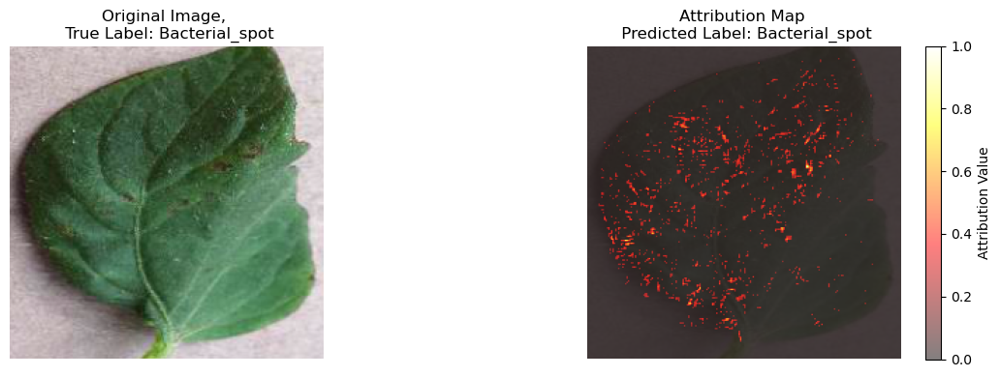

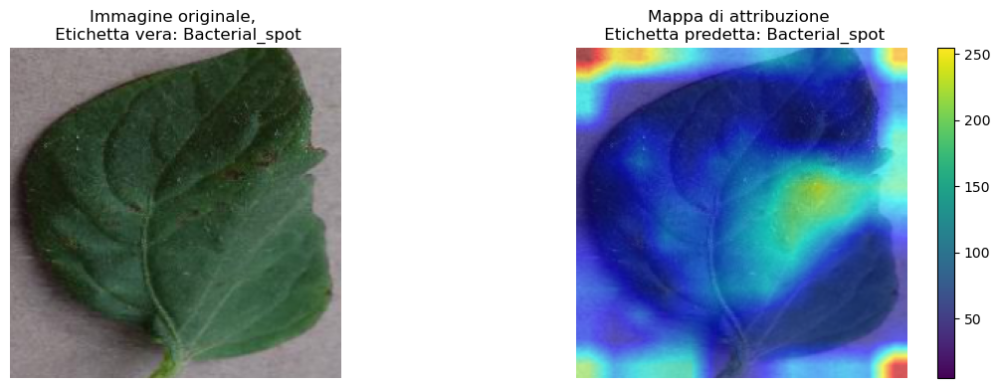

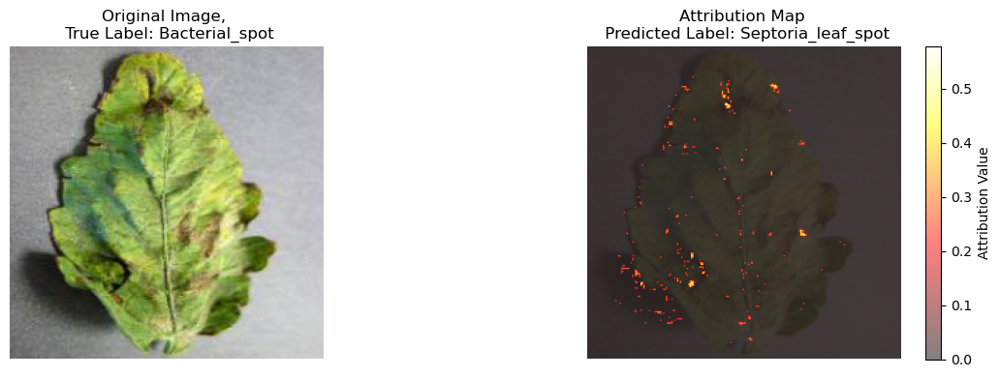

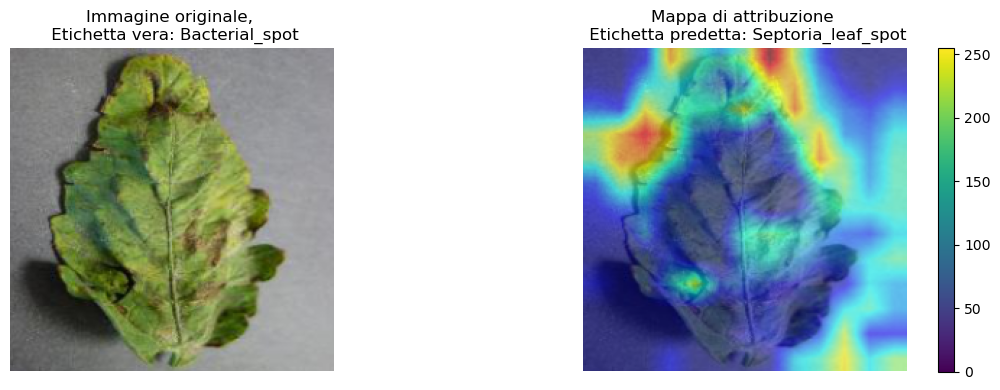

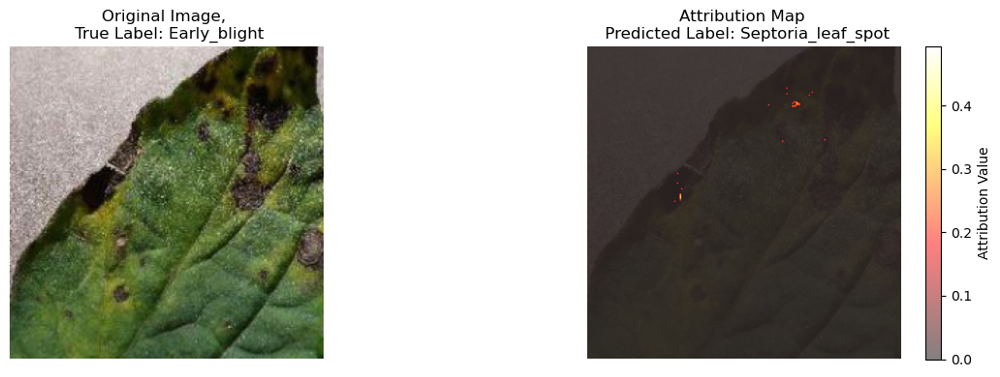

...

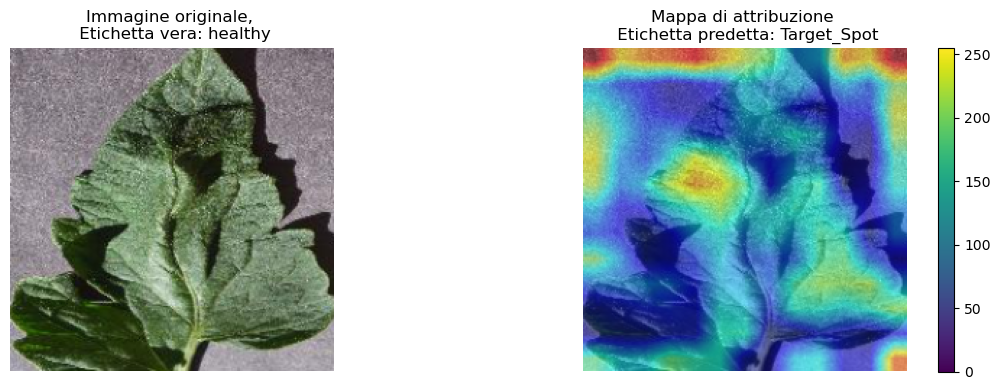

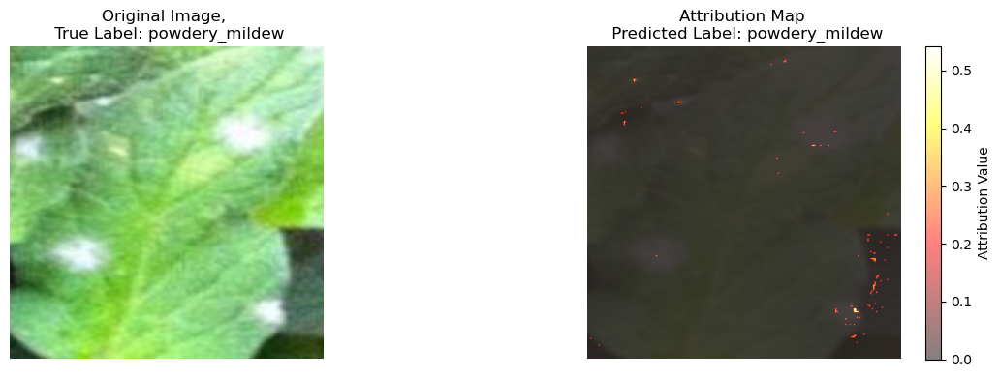

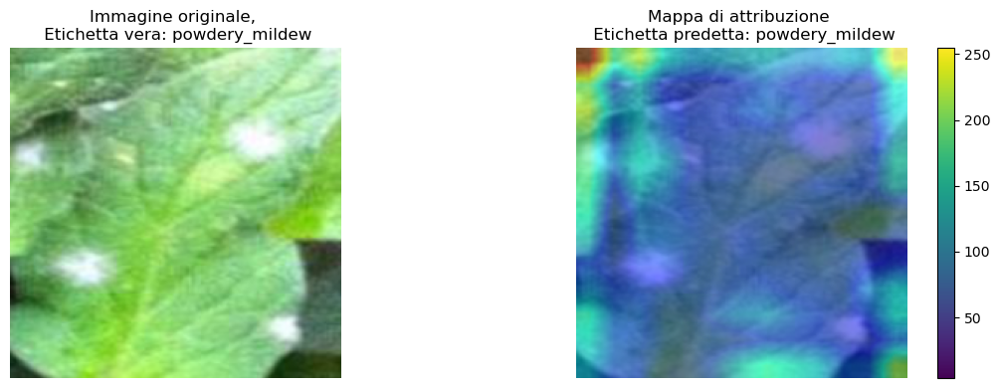

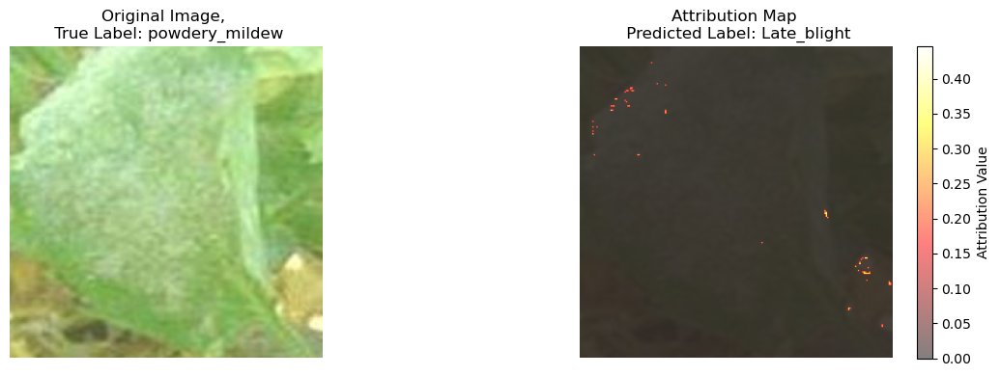

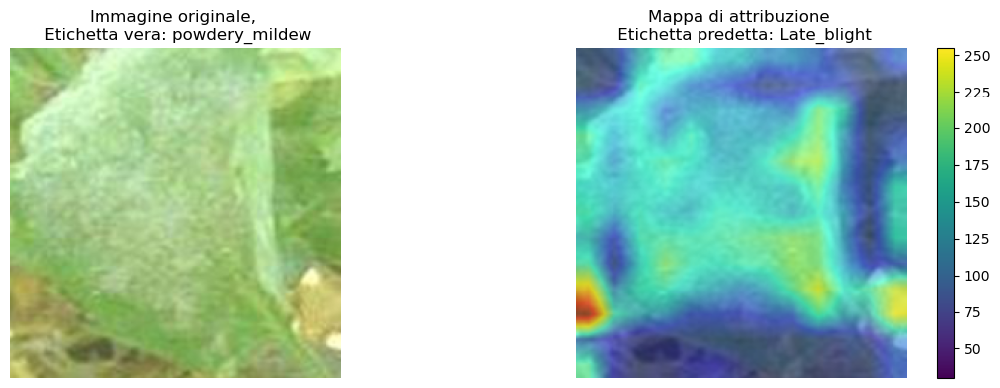

In [32]:
# Inizializza un dizionario per tenere traccia delle immagini già trovate per ogni classe
found_images = {class_idx: {'correct': False, 'incorrect': False} for class_idx in range(len(classes))}
threshold=0.2
# Ciclo attraverso il dataset di validazione
for image_idx, (image, label) in enumerate(data_val):
    image = image.unsqueeze(0).to(device)

    # Verifica se la predizione è corretta
    with torch.no_grad():
        output = net_feat_ext(image)
        predicted_class = output.argmax(dim=1).item()

    # Controlla se abbiamo già trovato un'immagine corretta o errata per questa classe
    if not found_images[label]['correct'] and predicted_class == label:
        # Prima immagine corretta trovata per questa classe
        true_class_name = classes[label]
        predicted_class_name = classes[predicted_class]
        """print(f"Image Index: {image_idx}")
        print(f"True Class: {true_class_name}")
        print(f"Predicted Class: {predicted_class_name}")"""

        # Call the function to visualize the image with attributions
        visualize_image_with_attributions(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold)
        visualize_image_with_gradcam(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold)

        found_images[label]['correct'] = True
    elif not found_images[label]['incorrect'] and predicted_class != label:
        # Prima immagine errata trovata per questa classe
        true_class_name = classes[label]
        predicted_class_name = classes[predicted_class]
        """
        print(f"Image Index: {image_idx}")
        print(f"True Class: {true_class_name}")
        print(f"Predicted Class: {predicted_class_name}")
        """
        # Call the function to visualize the image with attributions
        visualize_image_with_attributions(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold)
        visualize_image_with_gradcam(net_feat_ext, data_val, denormalize, classes, image_idx, label, predicted_class, threshold)
        found_images[label]['incorrect'] = True

    # Controlla se abbiamo trovato entrambe le immagini per questa classe
    if all(found_images[class_idx]['correct'] and found_images[class_idx]['incorrect'] for class_idx in range(len(classes))):
        break


Random model

In [14]:
# Get MobileNetV3 model
net_feat_ext = get_model('mobilenet_v3_large', True, num_classes)
net_feat_ext.to(device)

# Freeze the lower layers (convolutional layers)
set_requires_grad_for_layer(net_feat_ext.features, False)

# Print model summary
summary(net_feat_ext, input_size=(3, size_image, size_image))

/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V3_Large_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V3_Large_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /Users/akirapetrolini/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth


  0%|          | 0.00/21.1M [00:00<?, ?B/s]

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 112, 112]             432
       BatchNorm2d-2         [-1, 16, 112, 112]              32
         Hardswish-3         [-1, 16, 112, 112]               0
            Conv2d-4         [-1, 16, 112, 112]             144
       BatchNorm2d-5         [-1, 16, 112, 112]              32
              ReLU-6         [-1, 16, 112, 112]               0
            Conv2d-7         [-1, 16, 112, 112]             256
       BatchNorm2d-8         [-1, 16, 112, 112]              32
  InvertedResidual-9         [-1, 16, 112, 112]               0
           Conv2d-10         [-1, 64, 112, 112]           1,024
      BatchNorm2d-11         [-1, 64, 112, 112]             128
             ReLU-12         [-1, 64, 112, 112]               0
           Conv2d-13           [-1, 64, 56, 56]             576
      BatchNorm2d-14           [-1, 64,

In [15]:
# Training configuration
name_train = "mobilenetv3_feat_ext"
lr = 0.001
num_epochs = 10
execute(name_train, net_feat_ext, lr, num_epochs, loader_train, loader_val)

Epoch: 1  Lr: 0.00100000  Loss: Train = [1.4207] - Val = [0.7801]  Accuracy: Train = [58.75%] - Val = [77.51%]  Time one epoch (s): 896.0924 
Epoch: 2  Lr: 0.00100000  Loss: Train = [0.9271] - Val = [0.6131]  Accuracy: Train = [71.91%] - Val = [81.06%]  Time one epoch (s): 976.3503 
Epoch: 3  Lr: 0.00100000  Loss: Train = [0.8142] - Val = [0.5444]  Accuracy: Train = [74.10%] - Val = [82.45%]  Time one epoch (s): 979.1735 
Epoch: 4  Lr: 0.00100000  Loss: Train = [0.7598] - Val = [0.5076]  Accuracy: Train = [75.68%] - Val = [83.65%]  Time one epoch (s): 1070.1645 
Epoch: 5  Lr: 0.00100000  Loss: Train = [0.7213] - Val = [0.4704]  Accuracy: Train = [76.56%] - Val = [84.63%]  Time one epoch (s): 1075.1139 
Epoch: 6  Lr: 0.00010000  Loss: Train = [0.7083] - Val = [0.4668]  Accuracy: Train = [76.71%] - Val = [84.74%]  Time one epoch (s): 1034.1286 
Epoch: 7  Lr: 0.00010000  Loss: Train = [0.7035] - Val = [0.4648]  Accuracy: Train = [76.98%] - Val = [84.77%]  Time one epoch (s): 1180.4169 
Ep